# Code for Oscilloscope Version 2 
### Code has been cleaned up to show only interesting events
### Now add Gaussian fits for calculations

# Problems
1. first converter: needs variable timesteps from info file $\rightarrow$ otherwise integrating over it is futile

In [2]:
import pandas as pd
import numpy as np
import scipy as sp
import pyarrow.parquet as pq
import time
import matplotlib.pyplot as plt
import argparse
import csv
import pyarrow as pa 
from scipy.optimize import curve_fit
from scipy.stats import shapiro 

In [25]:
### first converter oscilloscope.csv -> cleaned.csv
RESOLUTION = 4e-11
BUFFER_SIZE = 50_000  # number of rows to buffer before writing

def convert_csv_to_csv_and_parquet(in_path, out_csv_path, out_parquet_path):
    buffer = []
    event_id = -1
    t0 = None
    idx = 0

    parquet_writer = None

    with open(in_path) as fin, open(out_csv_path, "w") as fout:
        # write CSV header
        fout.write("event_id,timestamp,Ch_1,Ch_2,Ch_3\n")

        for line in fin:
            line = line.strip()
            if not line:
                continue

            parts = line.split(";")

            # new event
            if len(parts) == 1:
                event_id += 1
                t0 = float(parts[0])
                idx = 0
                continue

            # data row
            if len(parts) == 3:
                timestamp = t0 + idx * RESOLUTION
                idx += 1
                x, y, z = map(float, parts)

                # add to buffer
                buffer.append([event_id, timestamp, x, y, z])

                # flush buffer if full
                if len(buffer) >= BUFFER_SIZE:
                    # write CSV
                    for row in buffer:
                        fout.write(f"{row[0]},{row[1]},{row[2]},{row[3]},{row[4]}\n")

                    # write Parquet
                    df = pd.DataFrame(buffer, columns=["event_id", "timestamp", "Ch_1", "Ch_2", "Ch_3"])
                    table = pa.Table.from_pandas(df)
                    if parquet_writer is None:
                        parquet_writer = pq.ParquetWriter(out_parquet_path, table.schema, compression='snappy')
                    parquet_writer.write_table(table)

                    buffer = []

                continue

            raise ValueError(f"Unexpected format: {line}")

        # flush remaining buffer
        if buffer:
            for row in buffer:
                fout.write(f"{row[0]},{row[1]},{row[2]},{row[3]},{row[4]}\n")
            df = pd.DataFrame(buffer, columns=["event_id", "timestamp", "Ch_1", "Ch_2", "Ch_3"])
            table = pa.Table.from_pandas(df)
            if parquet_writer is None:
                parquet_writer = pq.ParquetWriter(out_parquet_path, table.schema, compression='snappy')
            parquet_writer.write_table(table)

        if parquet_writer:
            parquet_writer.close()

In [24]:
### analysis of interesting events and ratio to empty events
def load_df(data): # load data no matter if already df or file
    # Case 1: filename 
    if isinstance(data, str):
        df = pd.read_csv(data)   
    
    # Case 2: already a DataFrame 
    elif isinstance(data, pd.DataFrame):
        df = data
    
    else:
        raise TypeError("Input must be a filename or a pandas DataFrame.")
    return df
    
def plot_all_channels(df, target_event = 0):
    # filter for target event
    event= df[df['event_id'] == target_event] 

    # plot
    plt.figure(figsize=(6,2))
    plt.plot(event["timestamp"], event["Ch_1"], label="Laser Trigger")
    plt.plot(event["timestamp"], event["Ch_2"], label="MCP PMT Camera")
    plt.plot(event["timestamp"], event["Ch_3"], label="HPD")
    plt.xlabel("Timestamp (s)")
    plt.ylabel("Signal")
    plt.title(f"Event {target_event}")
    plt.legend()
    plt.show()

def plot_only_camera(df, target_event = 0):
    # filter for target event
    event= df[df['event_id'] == target_event] 

    # plot
    plt.figure(figsize=(6,2))
    plt.plot(event["timestamp"], event["Ch_2"], label="MCP PMT Camera")
    plt.xlabel("Timestamp (s)")
    plt.ylabel("Signal")
    plt.title(f"Event {target_event}")
    plt.legend()
    plt.show()

def interesting_value_filter(df, min_thresh):
    # one grouped min over the whole DataFrame
    mins = df.groupby('event_id')['Ch_2'].min()
    # select only those event_ids whose min < threshold
    interesting_ids = mins[mins < min_thresh].index.to_list()
    return interesting_ids


def main_ratio(data, min_thresh = -0.01, show_plots=True):
    '''Usage:
        1. Input of the cleaned file after convert_csv_to_csv_and_parquet
        2. Define acceptable threshold for the minima one wants to accept
       Purpose:
        - takes an oscilloscope dataset and returns the ratio of 
    '''
    df = load_df(data)  # returns df if either pandas dataframe or directly from file
    interesting_ids = interesting_value_filter(df, min_thresh)
    
    ratio = len(interesting_ids)/(max(df['event_id'])+1)
    percentage = ratio * 100
    print(f'There are: {len(interesting_ids)} interesting events, that match the used threshold')
    # print(f'These events are numbered: {interesting_ids}')
    print(f'The percentage of interesting events to empty events is: {percentage:.5f}%')

    if show_plots:
        for i in interesting_ids:
            plot_all_channels(df, target_event=i)
            plot_only_camera(df, target_event=i)

There are: 161 interesting events, that match the used threshold
The percentage of interesting events to empty events is: 1.60984%


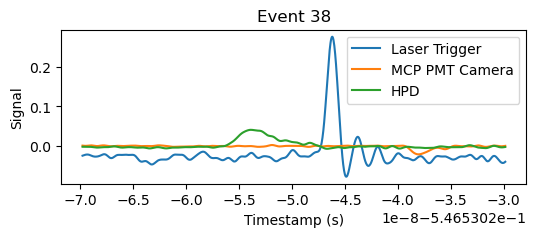

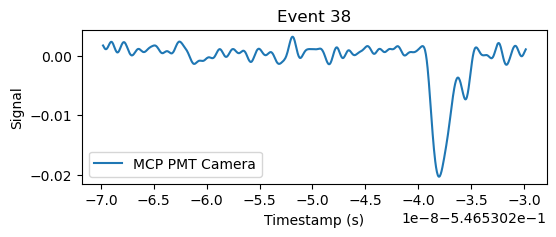

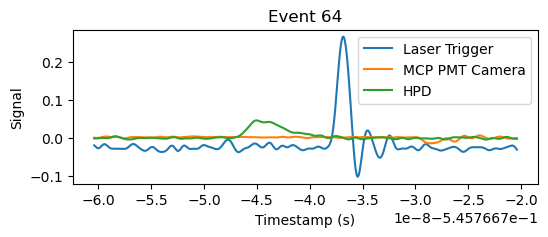

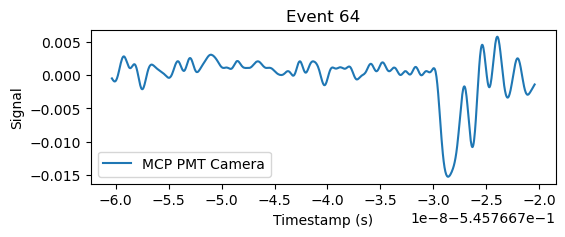

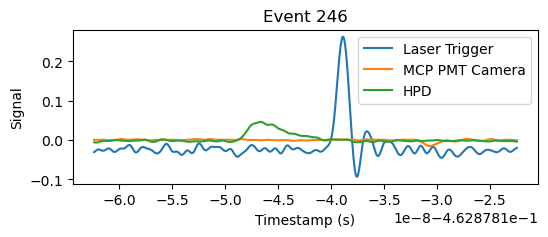

...

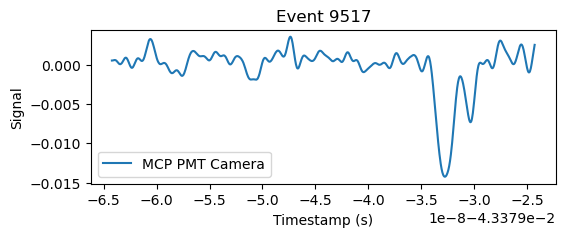

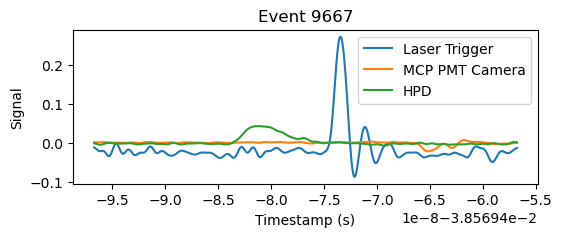

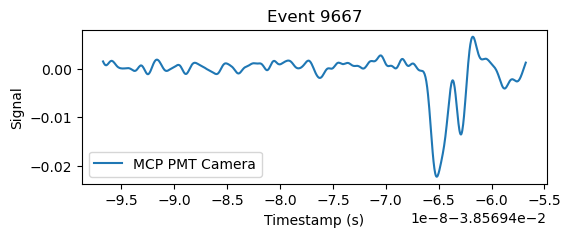

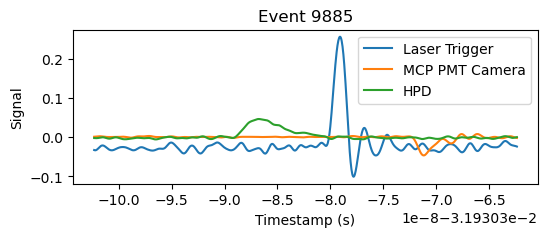

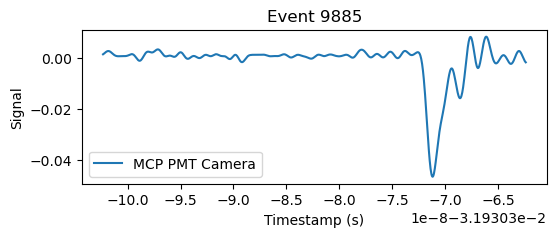

In [18]:
main_ratio('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_HPD_Run1.csv')

There are: 154 interesting events, that match the used threshold
The percentage of interesting events to empty events is: 1.53985%


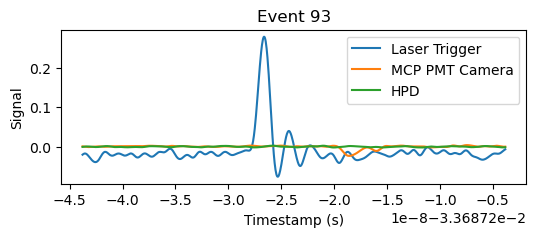

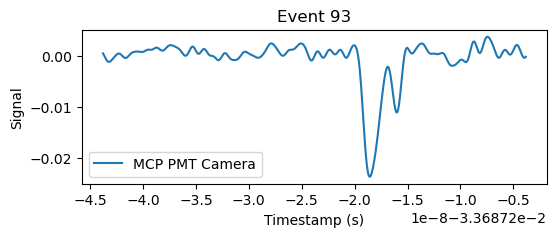

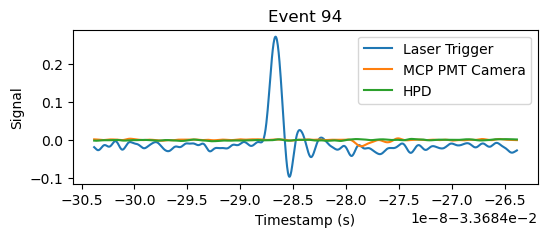

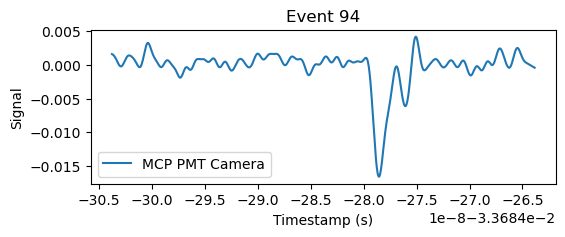

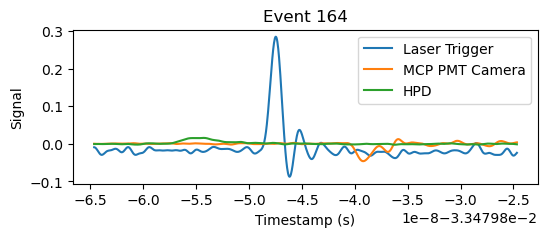

...

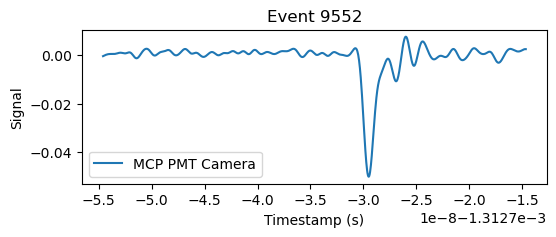

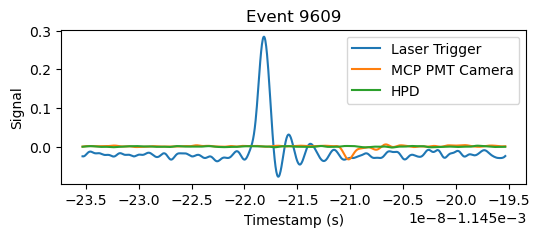

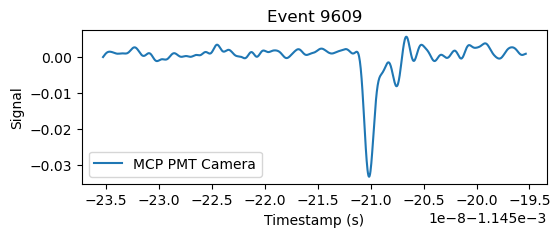

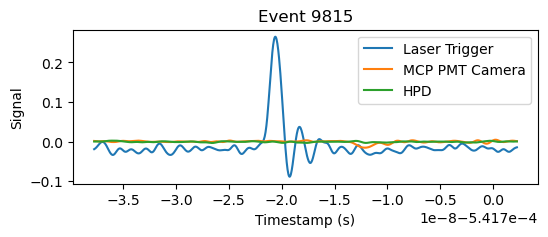

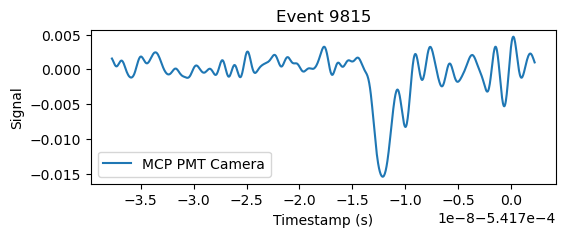

In [20]:
main_ratio('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_LaserTrigger_Run2.csv')

### Ratio analysis
1. the code for the ratio analysis is thus complete
2. this code can be used to estimate the ratio of interesting to empty events $\rightarrow$ use this to calibrate the light source

#### Caveats:
1. this is only a rough estimate based on few statistics
2. still need continue with the second part of the code $\rightarrow$ calculate area enveloped by pulses to calculate amplification of camera
3. $\textbf{Need to fix the timesteps the first converter uses}$

### Gaussian fit goals:
1. measure time jitters between the peaks
2. compute integral under peak for 

In [20]:
df = pd.read_csv('/Users/laloscola/Desktop/Max-Planck/Extreme Pro SSD data/magic data laboratory/cleaned_triggered_on_LaserTrigger_Run2.csv')

In [4]:
def gauss(x, A, mu, sigma, C):
        return A * np.exp(-0.5 * ((x - mu)/sigma)**2) + C

In [81]:
def fit_neg_gaussian_to_event(df, event_id = 0, channel="Ch_2"): 
    event = df[df["event_id"] == event_id].sort_values("timestamp")
    x = event["timestamp"].to_numpy()
    y = event[channel].to_numpy()

    # crude initial guesses
    A0 = y.min() - y.max()
    mu0 = x[np.argmin(y)] if A0 < 0 else x[np.argmax(y)]
    sigma0 = (x.max() - x.min()) / 10
    C0 = np.median(y)

    p0 = [A0, mu0, sigma0, C0]
    popt, pcov = curve_fit(gauss, x, y, p0=p0)
    return x, y, popt, pcov

In [83]:
def fit_pos_gaussian_to_event(df, event_id = 0, channel="Ch_1"):
    event = df[df["event_id"] == event_id].sort_values("timestamp")
    x = event["timestamp"].to_numpy()
    y = event[channel].to_numpy()

    # crude initial guesses
    A0 = y.max() - y.min()
    mu0 = x[np.argmin(y)] if A0 < 0 else x[np.argmax(y)]
    sigma0 = (x.max() - x.min()) / 10
    C0 = np.median(y)

    p0 = [A0, mu0, sigma0, C0]
    popt, pcov = curve_fit(gauss, x, y, p0=p0)
    return x, y, popt, pcov

In [85]:
def plot_event_with_gaussian(df, event_id = 0, channel="Ch_2"):
    x, y, popt, pcov = fit_neg_gaussian_to_event(df, event_id, channel=channel)
    x_fit = x
    y_fit = gauss(x_fit, *popt)

    plt.figure(figsize=(6, 3))
    plt.plot(x, y, "o", ms=2, label=f"Data {channel}")
    plt.plot(x_fit, y_fit, "-", label="Gaussian fit")
    plt.xlabel("Timestamp (s)")
    plt.ylabel("Signal")
    plt.title(f"Event {event_id} – Gaussian fit")
    plt.legend()
    plt.tight_layout()
    plt.show()

In [22]:
df.head()

,event_id,timestamp,Ch_1,Ch_2,Ch_3
0,0,-0.03396,-0.025393,0.000863,-0.000025
1,0,-0.03396,-0.026072,0.000832,-0.000102
2,0,-0.03396,-0.026875,0.000808,-0.000199
3,0,-0.03396,-0.027740,0.000783,-0.000315
4,0,-0.03396,-0.028604,0.000771,-0.000443


In [87]:
def main_gauss_plots(data, min_thresh = -0.01, show_plots=True):
    '''Usage:
        1. Input of the cleaned file after convert_csv_to_csv_and_parquet
        2. Define acceptable threshold for the minima one wants to accept
       Purpose:
        - takes an oscilloscope dataset and returns the ratio of 
    '''
    df = load_df(data)  # returns df if either pandas dataframe or directly from file
    interesting_ids = interesting_value_filter(df, min_thresh)

    for i in interesting_ids:
        plot_event_with_gaussian(df, event_id = i)

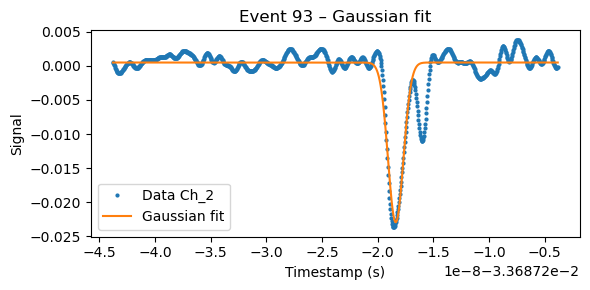

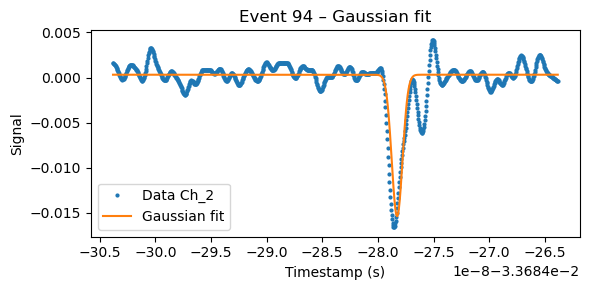

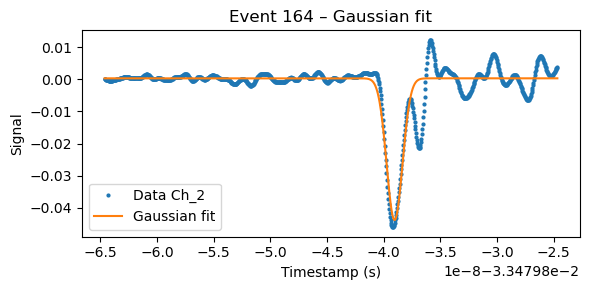

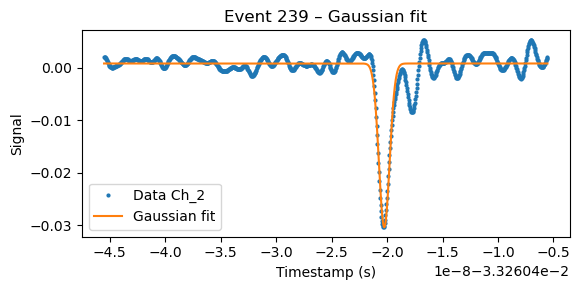

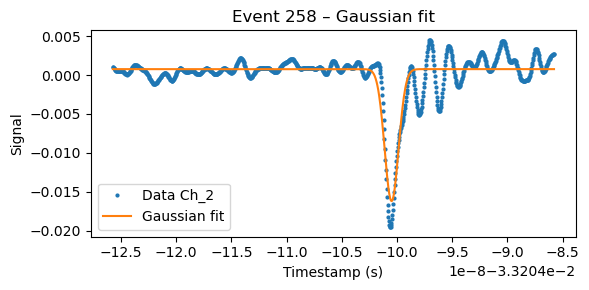

...

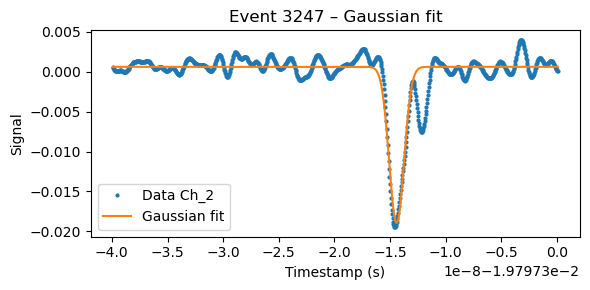

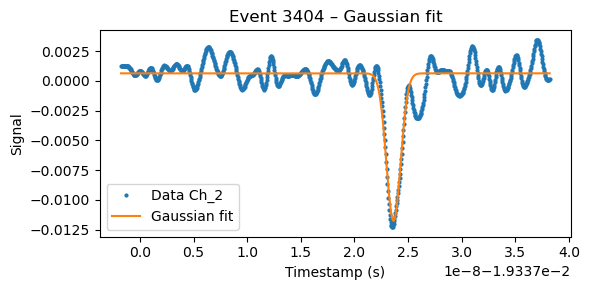

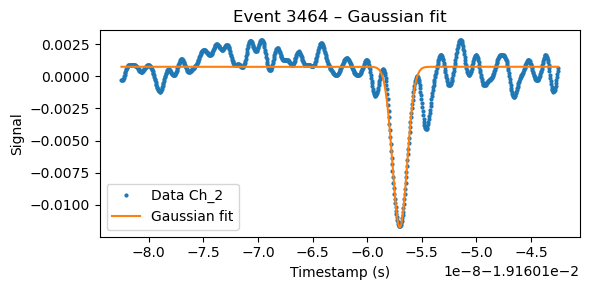

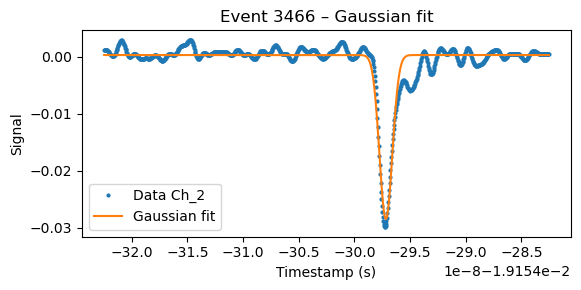

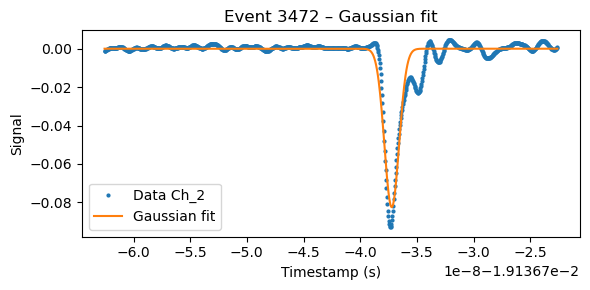

RuntimeError: Optimal parameters not found: Number of calls to function has reached maxfev = 1000.

In [89]:
main_gauss_plots(df)  # fitting timed out for event 3565 (which is in fact not gaussian)

### Commentary:
- the Gaussian fits aren't ideal for real calculations -> jitter should work well, $\textcolor{red}{but}$ gaussian is probably not the best idea for the integration

### 2nd phase of code
- put a gauss fit on laser trigger signal too
- plot both with rescaled laser trigger signal for comparison
- calculate jitter time between camera and laser trigger
- for jitter calculation -> old code with FWHM jitter timing? or simply create list between peak time differences?